# Berkeley, BOEM Facies Project
<br>
Introduction, Seismic Plotting, Attribute quick look, convert .sgy to numpy arrays <br>
** Must install the segyio library <br>
Code: Kevin Smith, Kim Baldwin

---

#### BOEM Background:

- BOEM: Bureau of Ocean Energy Management within the Department of the Interior (DOI). <br>
    - Federal government agency
    - “The Mission… is to manage development of U.S. Outer Continental Shelf energy and mineral resources in an environmentally and economically responsible way.”
- We are the Lease Management Section, Pacific Region
    - Manage resources in federal waters off the coasts of California, Oregon, Washington, and Hawaii. 
    - Oil and gas, renewable energy, marine minerals
    - Soon: carbon sequestration
- We are stewards of the resources, but also the data!
    - A lot of data collected in the 60's, 70's and 80's. 
    - These types of data/ location of data may never be collected again
    - We want to find different ways to explore  the datasets that we have, to further our Region's goals.


#### That's where you come in!

- We want to use machine learning to cluster + classify groups within a two dimensional seismic profile. 
- Think of a seismic profile as a 2D image of the rocks below your feet, much like the rock outcrops you might see on the side of the highway
- The data:
    - Think of like a numpy array
    - x direction represents distance, y direction represents depth (or in our case time).
    - The original signal represents amplitude- you can think of it like the strength of the signal receieved, with both positive and negative values. +1 and -1 have the same "strength", but in different ways
    - Can use algorithms to process the orginial signal to get attributes that describe the image in different ways, more on that later
- Ultimately want to be able to assign clusters a geologic interpretation, or seismic facies based on the relationship between values

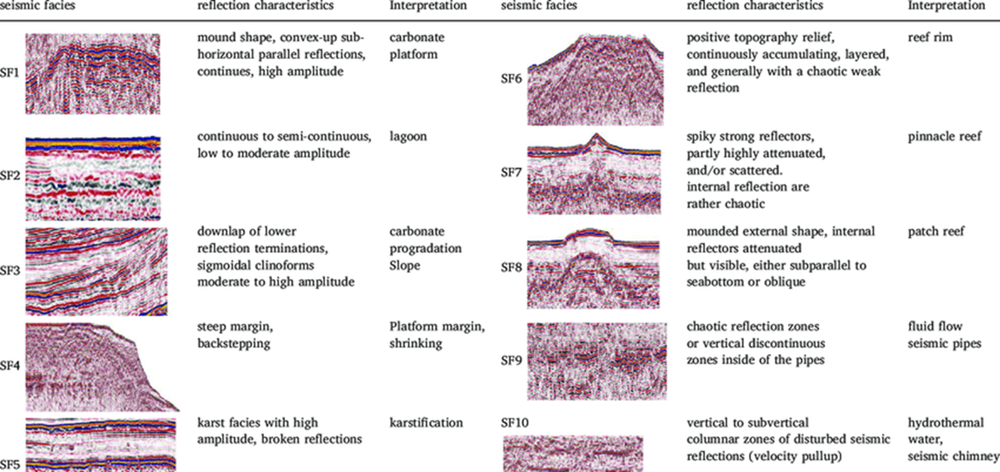

----

#### Import modules

In [1]:
import segyio
import pandas as pd 
import numpy as np
import seaborn as sns 
from matplotlib import pyplot as plt
import os

ModuleNotFoundError: No module named 'segyio'

#### Set variables

In [8]:
# Folder location where seismic files are stored
# include r before path, if path contains backslash
path = '/Users/rishikhare/Downloads/DOI-SeismicFacies/Seismic_files'

## Plot a seismic line

In [10]:
# Use segyio to import seismic line
# Returns: file – An open segyio file handle
# Return type: segyio.SegyFile
# Use np.stack to create numpy array

with segyio.open(os.path.join(path, "WNC82_017.sgy"), strict=False) as s:
    data = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

In [11]:
# Set data clip for better viewing
clip_percentile = 96
vm = np.percentile(data, clip_percentile)

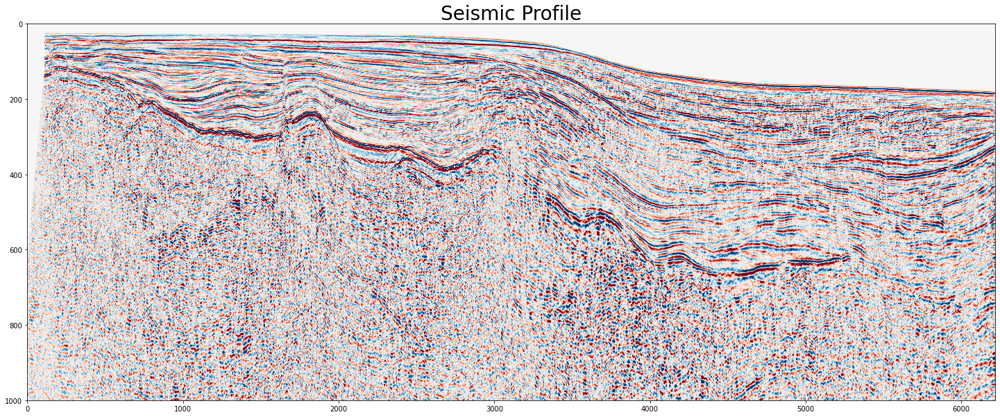

In [12]:
# Plot with Matplotlib
plt.figure(figsize=(25,10))                                                  # Set figure dimensions
plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto')            # Show image
plt.ylim([1000, 0])                                                          # Set y scale
plt.title('Seismic Profile', fontsize=28)
plt.show()

In [ ]:
# Vertical axis = the number of time samples, NOT two way travel time

In [10]:
data.shape #number of traces, number of time samples

(6220, 1775)

## Add seismic attributes

### Local Strucural Dip
The estimation of local dip from the seismic data. <br>
Used the "Event" method: the downslope dip (0..90) of the estimated event. The gradient is assumed to be perpendicular to the event.


In [14]:
with segyio.open(os.path.join(path, "WNC82_017_Local_Structural_Dip.sgy"), strict=False) as s:
    lsd = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

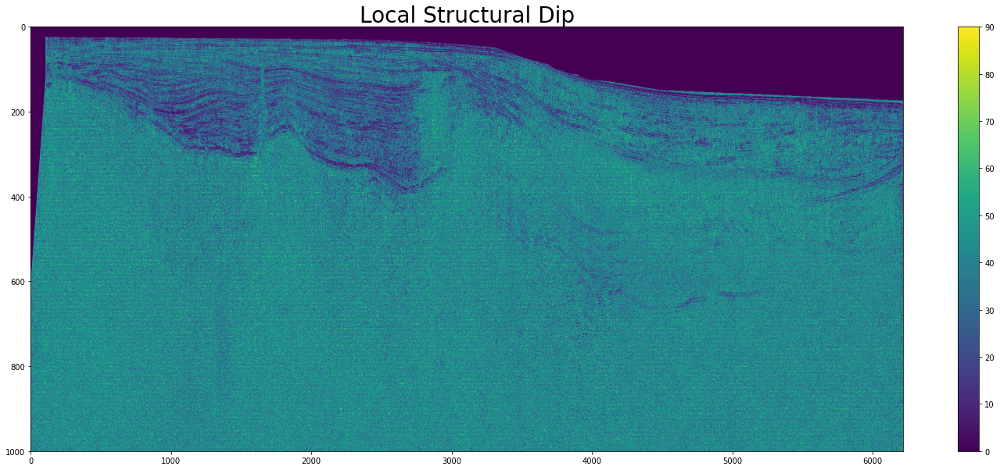

In [15]:
plt.figure(figsize=(25,10))
plt.imshow(lsd.T, cmap='viridis', aspect='auto')
#plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto', alpha=.3)     # Add seismic in background
plt.ylim([1000, 0]) # Set y scale
plt.colorbar() 
plt.title('Local Structural Dip', fontsize=28)
plt.show()

In [29]:
lsd.shape #number of traces, number of time samples

(6220, 1775)

### Amplitude Contrast
Reveals discontinuities in seismic data, either related
to stratigraphic terminations or structural lineaments.

In [16]:
with segyio.open(os.path.join(path, "WNC82_017_Amplitude_Contrast.sgy"), strict=False) as s:
    ampc = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

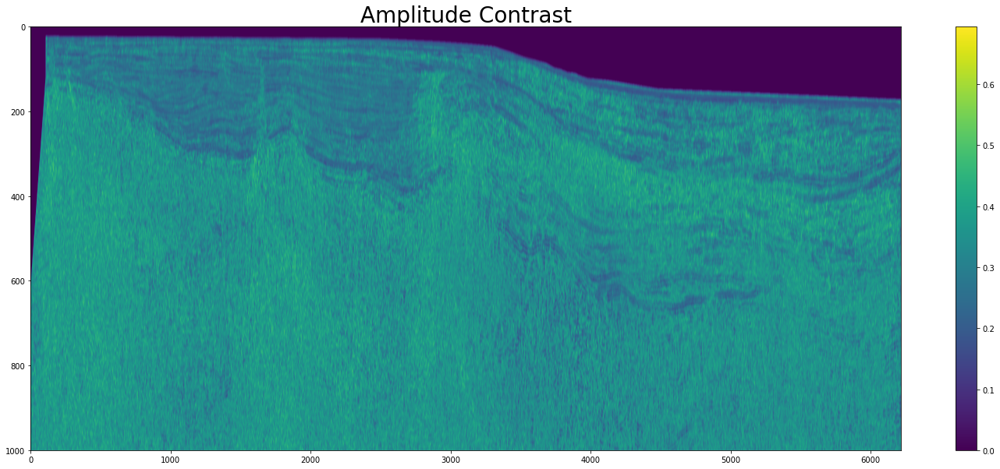

In [17]:
plt.figure(figsize=(25,10))
plt.imshow(ampc.T, cmap='viridis', aspect='auto')
#plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto', alpha=.2)     # Add seismic in background
plt.ylim([1000, 0])                                                              # Set y scale
plt.colorbar()
plt.title('Amplitude Contrast', fontsize=28)
plt.show()

### Instantaneous Frequency
Time derivitive of the phase. <br>
Bed thickness indicator and can detect lateral changes in lithology

In [18]:
with segyio.open(os.path.join(path, "WNC82_017_Instantaneous_Freq.sgy"), strict=False) as s:
    ifq = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

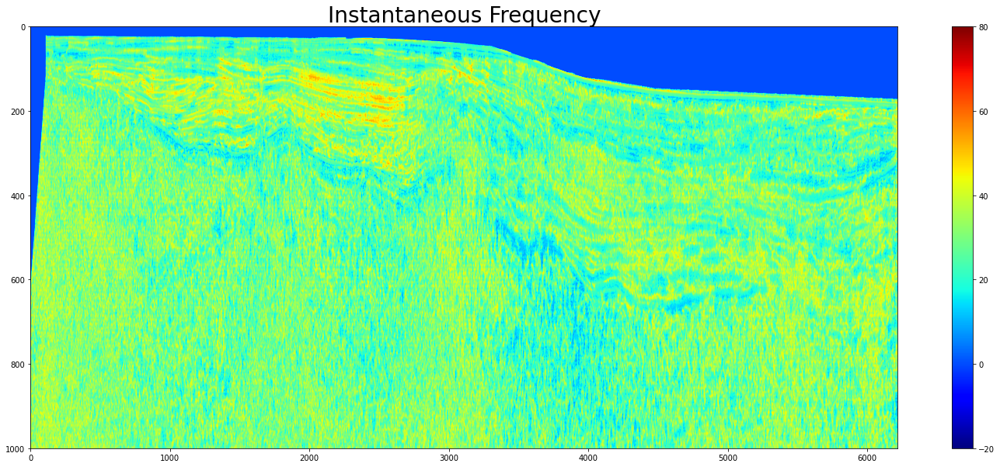

In [19]:
plt.figure(figsize=(25,10))
plt.imshow(ifq.T, cmap='jet', aspect='auto', vmin=-20, vmax=80)
#plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto', alpha=.1)     # Add seismic in background
plt.ylim([1000, 0])                                                              # Set y scale
plt.title('Instantaneous Frequency', fontsize=28)
plt.colorbar()
plt.show()    

### RMS Amplitude
Computes Root Mean Squares on instantaneous trace samples over a specified window. <br>
Classical attribute for bright spot detection (highly correlated to envelope).

In [20]:
with segyio.open(os.path.join(path, "WNC82_017_RMS_Amplitude.sgy"), strict=False) as s:
    rmsa = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

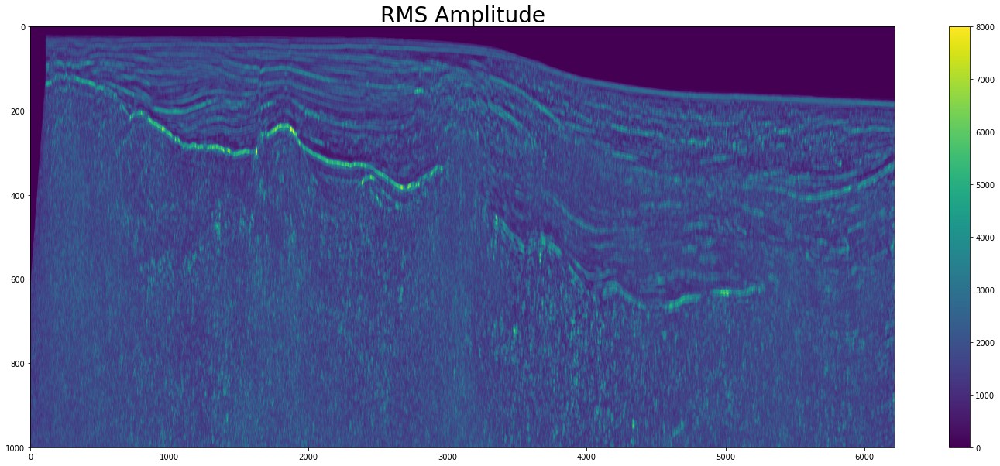

In [21]:
plt.figure(figsize=(25,10))
plt.imshow(rmsa.T, cmap='viridis', aspect='auto', vmin=0, vmax=8000)
#plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto', alpha=.1)     # Add seismic in background
plt.ylim([1000, 0]) 
plt.title('RMS Amplitude', fontsize=28)
plt.colorbar()
plt.show() 

### Chaos
Maps the “chaoticness” of the local seismic signal from statistical analysis of dip/azimuth estimate. <br>
Useful for identifying channel infill, gas chimneys, reef internal texture, sink holes, salt diapir, shale diaper. Also a good discriminator for seismic facies analysis.

In [22]:
with segyio.open(os.path.join(path, "WNC82_017_Chaos.sgy"), strict=False) as s:
    chaos = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

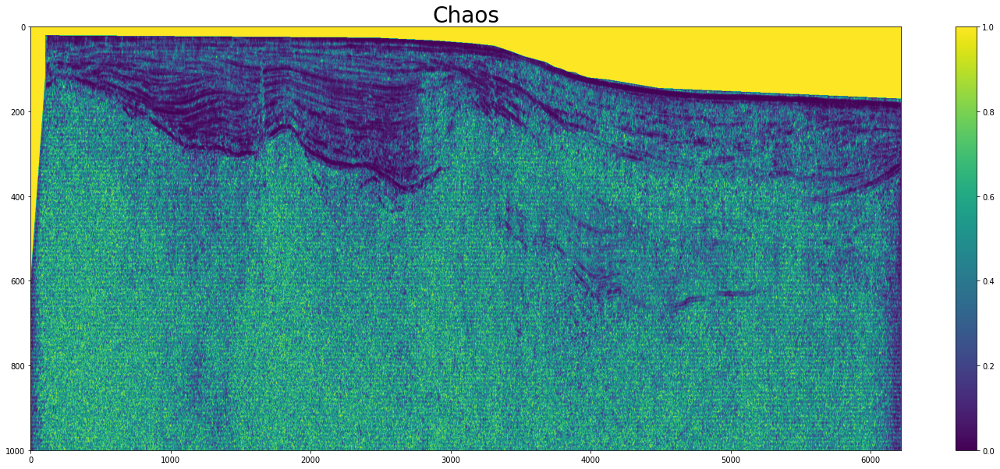

In [23]:
plt.figure(figsize=(25,10))
plt.imshow(chaos.T, cmap='viridis', aspect='auto')
#plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto', alpha=.1)     # Add seismic in background
plt.ylim([1000, 0]) 
plt.title('Chaos', fontsize=28)
plt.colorbar()
plt.show() 

### Variance
Signal coherency analysis: Estimates trace-to-trace variance (1-semblance). Amplitude Invariant (but not orientation invariant); i.e., it will produce the same response for the same seismic signature, whether in a low- or high-amplitude region. <br>
Can discriminate between low and high continuity of seismic reflections. Interpretation of progradational versus aggredational stacking patterns on stratal slices.

In [24]:
with segyio.open(os.path.join(path, "WNC82_017_Variance.sgy"), strict=False) as s:
    var = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

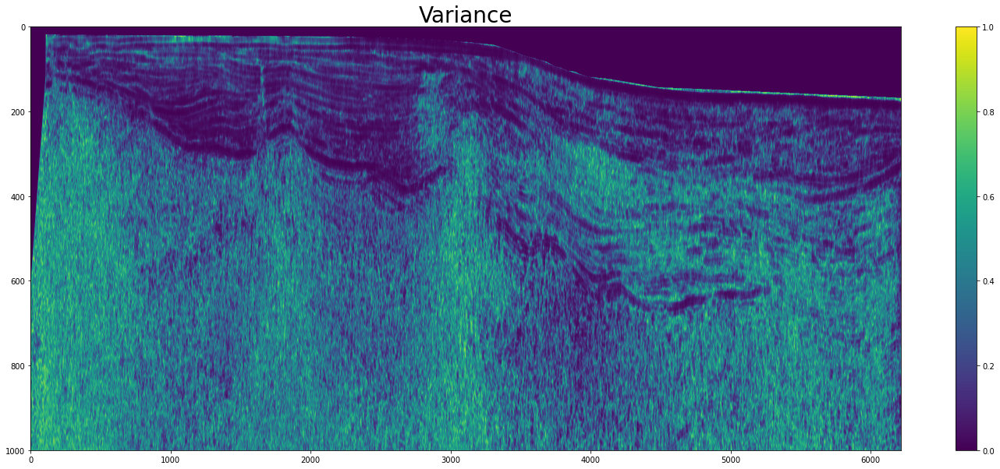

In [25]:
plt.figure(figsize=(25,10))
plt.imshow(var.T, cmap='viridis', aspect='auto')
#plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto', alpha=.1)     # Add seismic in background
plt.ylim([1000, 0])
plt.colorbar()
plt.title('Variance', fontsize=28)
plt.show()

### Iso-frequency, 54 Hz
This attribute helps to measure cyclicity of geological intervals and can be useful for cross-correlation across faults.

In [26]:
with segyio.open(os.path.join(path, "WNC82_017_iso_freq_54hz.sgy"), strict=False) as s:
    hz54 = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

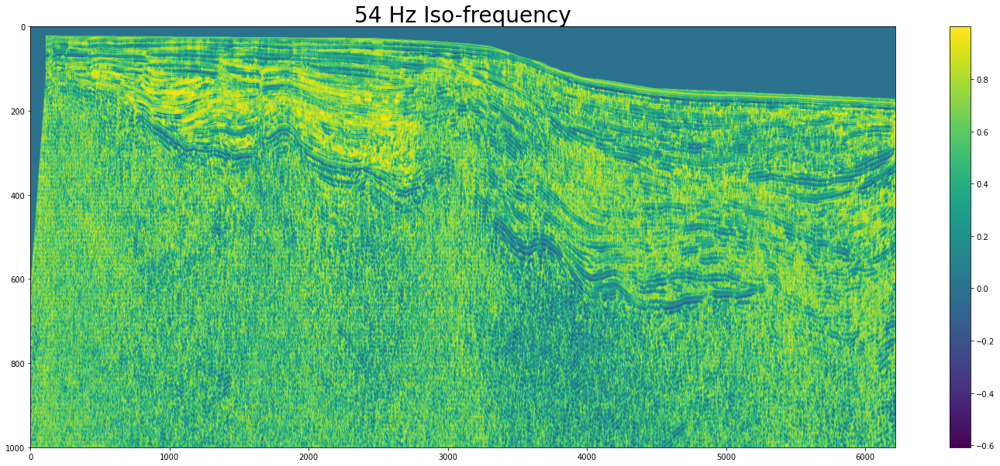

In [27]:
plt.figure(figsize=(25,10))
plt.imshow(hz54.T, cmap='viridis', aspect='auto')
#plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto', alpha=.1)     # Add seismic in background
plt.ylim([1000, 0])
plt.colorbar()
plt.title('54 Hz Iso-frequency', fontsize=28)
plt.show()

### Instantaneous Phase
Description of the phase angle at any instant along a trace independent of amplitude. It reveals weak and strong events with equal strength. <br>
Discriminator for geometrical shape. Good indicator of continuities, angular unconformities, faults, pinch-outs, sequence boundaries, and onlap patterns.

In [28]:
with segyio.open(os.path.join(path, "WNC82_017_Instantaneous_Phase.sgy"), strict=False) as s:
    iph = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

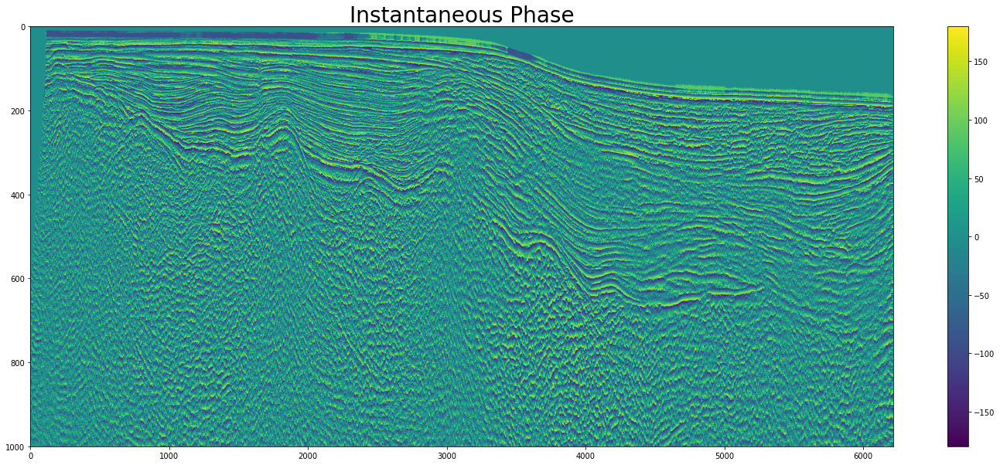

In [29]:
plt.figure(figsize=(25,10))
plt.imshow(iph.T, cmap='viridis', aspect='auto')
#plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto', alpha=.1)     # Add seismic in background
plt.ylim([1000, 0])
plt.colorbar()
plt.title('Instantaneous Phase', fontsize=28)
plt.show()

### First Derivative
Time rate of change of the amplitude. <br>

In [30]:
with segyio.open(os.path.join(path, "WNC82_017_First_derivative.sgy"), strict=False) as s:
    d1 = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

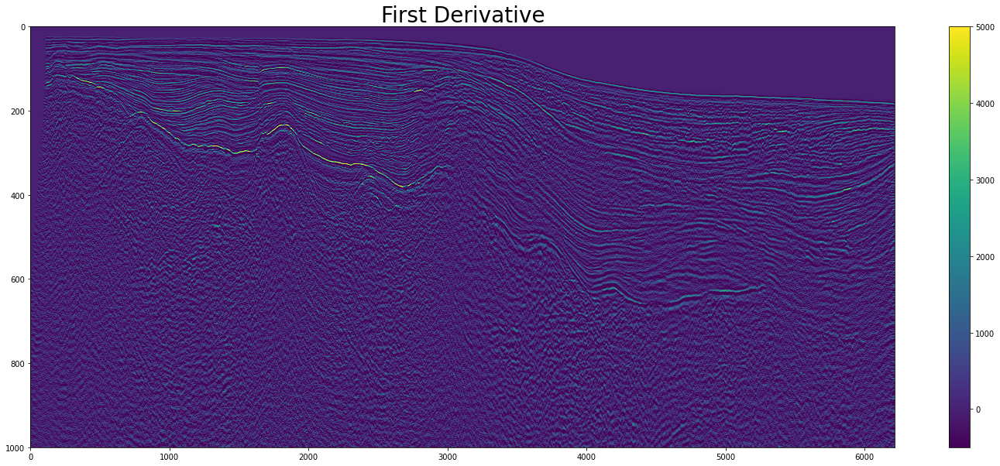

In [31]:
plt.figure(figsize=(25,10))
plt.imshow(d1.T, cmap='viridis', aspect='auto', vmin=-500, vmax=5000)
#plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto', alpha=.1)     # Add seismic in background
plt.ylim([1000, 0])
plt.colorbar()
plt.title('First Derivative', fontsize=28)
plt.show()

### Generalized Spectral Decomposition
Spectral decomposition unravels the seismic signal into its constituent frequencies, allowing the interpreter to delineate
subtle geologic features (amplitude and/or phase) tuned at a specific frequency. <br>
Identification of thin beds and subtle stratigraphic features (e.g. pinch-out, reefs, channels)

In [32]:
with segyio.open(os.path.join(path, "WNC82_017_generalized_spectral_decomposition.sgy"), strict=False) as s:
    gsd = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

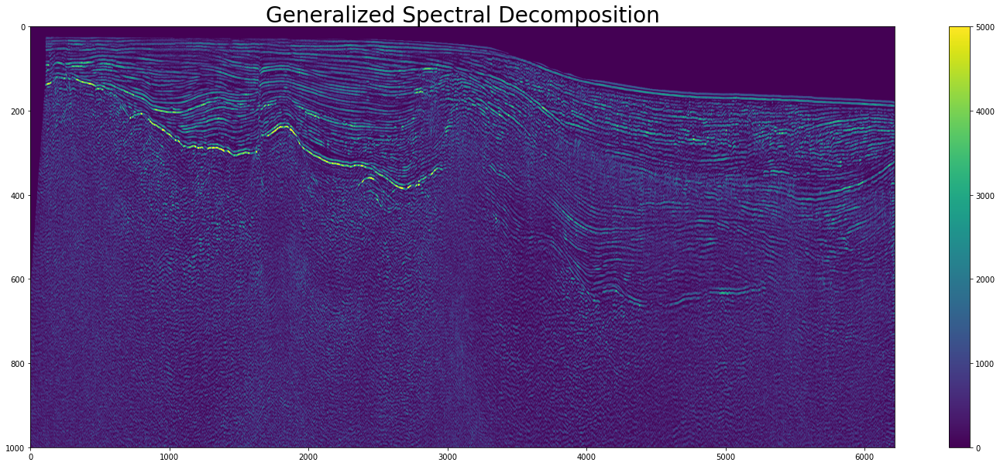

In [33]:
plt.figure(figsize=(25,10))
plt.imshow(gsd.T, cmap='viridis', aspect='auto', vmin=0, vmax=5000)
#plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto', alpha=.1)     # Add seismic in background
plt.ylim([1000, 0])
plt.colorbar()
plt.title('Generalized Spectral Decomposition', fontsize=28)
plt.show()

### Local Flatness
Maps the flatness of the local seismic signal. It is the degree to which local reflectors are flat/planar. <br>
Good stratigraphic indicator—reef internal texture, sink holes, channel infill.

In [34]:
with segyio.open(os.path.join(path, "WNC82_017_Flatness.sgy"), strict=False) as s:
    flat = np.stack(t.astype(np.float) for t in s.trace)  # This is an np array

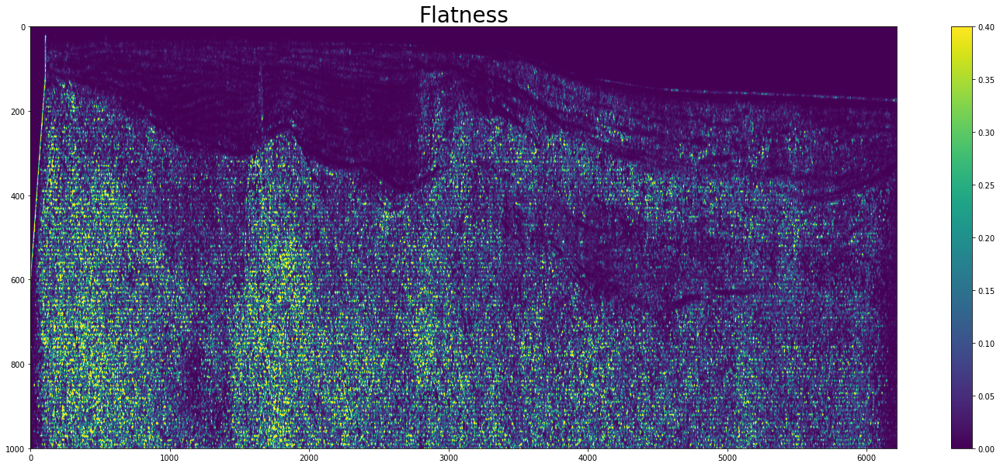

In [35]:
plt.figure(figsize=(25,10))
plt.imshow(flat.T, cmap='viridis', aspect='auto', vmin=0, vmax=0.4)
#plt.imshow(data.T, cmap="RdBu", vmin=-vm, vmax=vm, aspect='auto', alpha=.1)     # Add seismic in background
plt.ylim([1000, 0])
plt.colorbar()
plt.title('Flatness', fontsize=28)
plt.show()

## Dataset Characteristics

- 11 attributes + seismic amplitude (original data) = 12 attributes
- All formated in numpy arrays with the shape (6220, 1775)

## Deliverables

- Jupyter notebook with code
- Make sure to include markdown to explain what you did
- Visuals are always appreciated

## Things to think about:
- Decide how you are going to handle the data: numpy arrays? pandas dataframes? something else?
- Data Exploration, feature importance, what ML algorithms to use?
- How to evaluate your model? What metrics will you use?

In [ ]:
from sklearn.cluster import KMeans

for k in np.arange(10):
  X = 
  kmeans = KMeans(n_clusters=2, random_state=0, n_init="auto").fit(X)
  kmeans.labels_